In [1]:
import glob
from multiprocessing import Pool

import anndata as ad
import matplotlib as plt
import numpy as np
import pandas as pd
import scanpy as sc
import scvelo as scv
import seaborn as sns

# Set the number of max CPUs to be used by the processes
from threadpoolctl import threadpool_limits

cpus = 4
threadpool_limits(cpus)

In [2]:
# Get the customised LOOM files (here I specify only the MUI dataset)
loom_files = []
loom_path = "/data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/*MUI_Innsbruck-P*.loom"
for file in glob.glob(loom_path, recursive=True):
    loom_files.append(file)

In [3]:
# Load in the files as adata - this will take ages due to the size of the loom files, need to use multiprocessing
# Function to process a single Loom file (will be used for multiprocessing pool)
def process_loom_file(lfile):
    print("processing: " + lfile)
    ladata = scv.read(lfile, cache=False)
    ladata.var_names_make_unique()
    return ladata


# Number of processes to use
# num_processes = os.cpu_count()  # Run only if you want to use the number of all available CPU cores
num_processes = 4

# Create a multiprocessing Pool
with Pool(processes=num_processes) as pool:
    ladata_list = pool.map(process_loom_file, loom_files)

# Concatenate the processed Loom files
ladata_merged = ad.concat(ladata_list)

processing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P4.loom
processing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P14.loomprocessing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P12.loomprocessing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P3.loom


processing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P9.loom
processing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P8.loom
processing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P16.loom
processing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P5.loom
processing: /data/projects/2022/CRCA/results/RNA_velocity/velocyto_results/custom_loom/MUI_Innsbruck-P15.loom
processing: /da

In [4]:
# Check the index
ladata_merged.obs

""
CellID
MUI_Innsbruck-P4-10027828
MUI_Innsbruck-P4-10027036
MUI_Innsbruck-P4-10027087
MUI_Innsbruck-P4-10012
MUI_Innsbruck-P4-10028170
...
MUI_Innsbruck-P7-9916123
MUI_Innsbruck-P7-9916036
MUI_Innsbruck-P7-9916049


In [5]:
# Load in the H5AD data
adata = sc.read_h5ad(
    "/home/fotakis/myScratch/tools/crc-atlas/scripts/MUI_only_neutro_latest.h5ad"
)

In [6]:
# We need to change the IDs in order to match the IDs in the LOOM files
old_id = "Trajanoski_2023"
new_id = "MUI_Innsbruck"

adata.obs.index = [bc.replace(old_id, new_id) for bc in adata.obs.index.tolist()]

In [ ]:
# Check the new index
adata.obs

In [7]:
# Merge the H5AD and LOOM adata
adata_merged = scv.utils.merge(adata, ladata_merged)

# Steady state model

In [8]:
# Norm and filter
scv.pp.filter_and_normalize(adata_merged)
scv.pp.moments(adata_merged)

Normalized count data: X, spliced, unspliced.


/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/preprocessing/utils.py:705: DeprecationWarning: `log1p` is deprecated since scVelo v0.3.0 and will be removed in a future version. Please use `log1p` from `scanpy.pp` instead.
  log1p(adata)


Logarithmized X.
computing neighbors
    finished (0:00:42) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:38) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


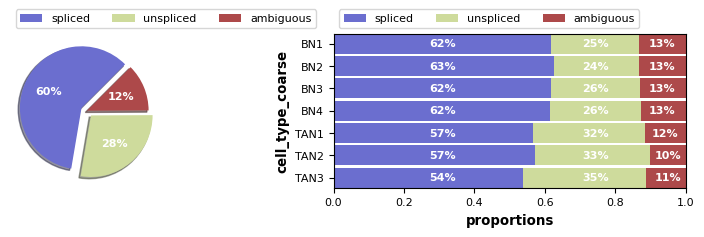

In [9]:
scv.pl.proportions(adata_merged, groupby='cell_type_coarse')

In [10]:
# Compute the velocity
scv.tl.velocity(
    adata_merged,
    group="cell_type_coarse"
)

computing velocities


/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/tools/optimization.py:184: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  gamma[i] = np.linalg.pinv(A.T.dot(A)).dot(A.T.dot(y[:, i]))


    finished (0:08:37) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


In [11]:
# Create the velocity graph embedding
scv.tl.velocity_graph(
    adata_merged,
    n_jobs=4
)

computing velocity graph (using 4/64 cores)


  0%|          | 0/27443 [00:00<?, ?cells/s]

    finished (0:02:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding


/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scanpy/_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)


    finished (0:00:26) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-package

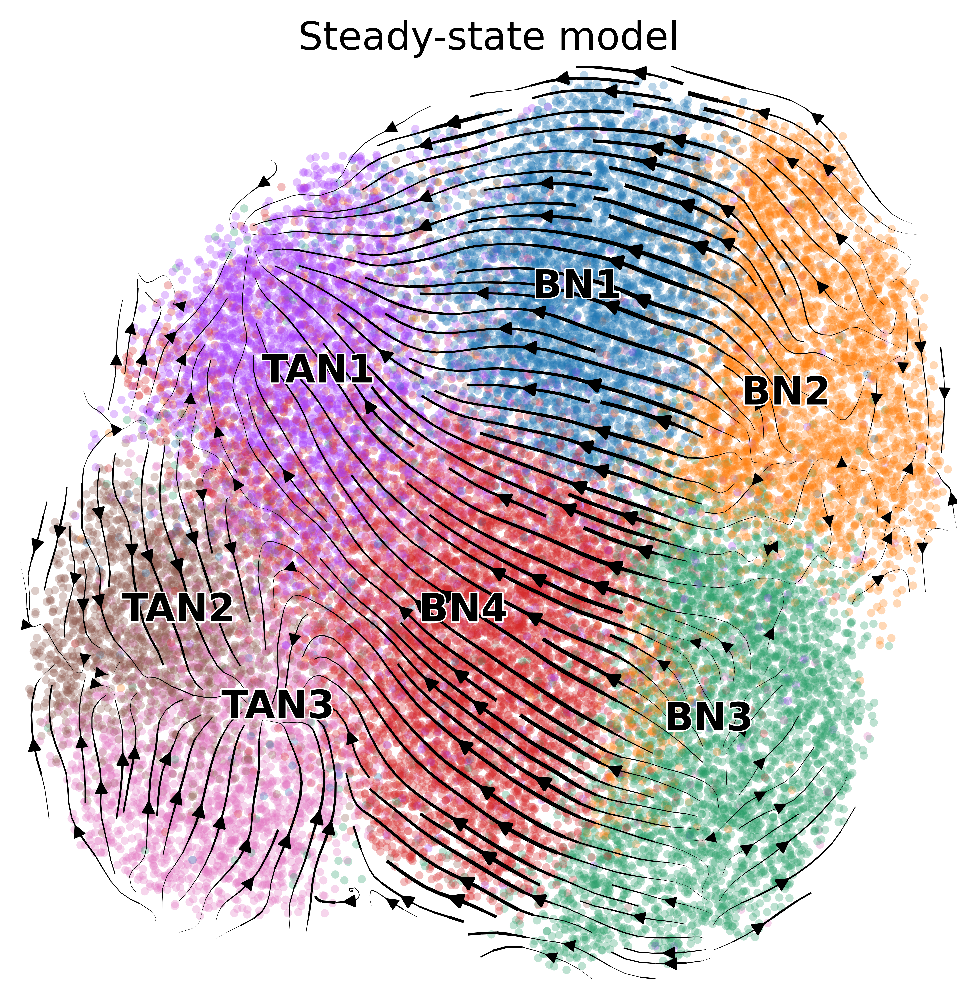

In [12]:
# Plot and save the velocity graph (steady-state)
# Note: The default figure params are changed here (I find these params produce more "readable" plots)
# Feel free to change
sc.set_figure_params(figsize=(6, 6), dpi=400)
# remove the grid lines
plt.rcParams["axes.grid"] = False
scv.pl.velocity_embedding_stream(
    adata_merged,
    basis="umap",
    color="cell_type_coarse",
    title="Steady-state model",
    legend_loc="on data",
    save="scvelo_steady_state_neutro.png",
)

# Psuedotime

In [ ]:
# We first need to assess the root cell.
# In order to do that we need to plot the diffusion maps
sc.tl.diffmap(adata_merged)

In [ ]:
# Check the first 2 diffusion components
sc.pl.scatter(
    adata_merged,
    basis="diffmap",
    color=["cell_type_coarse"],
    components=[1, 2],
)

In [ ]:
# In order to decide for a root cell we need to look at the extremities of the graph
# Since we expect that the initial state lies in the BN clusters we can focus on the upper right extremity
# As it is evident the most likely root cell would belong to cluster BN2
# Set the root cell:
adata_merged.uns['iroot'] = np.flatnonzero(adata_merged.obs['cell_type_coarse'] == 'BN2')[0]

In [ ]:
# Print the root cell - needed for the pseudotime clalculation:
adata_merged.uns['iroot']

In [13]:
# Compute the pseudotime using the root cell
scv.tl.velocity_pseudotime(adata_merged, root_key=11)

/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-package

saving figure to file ./figures/scvelo_MUI_pseudotime.png


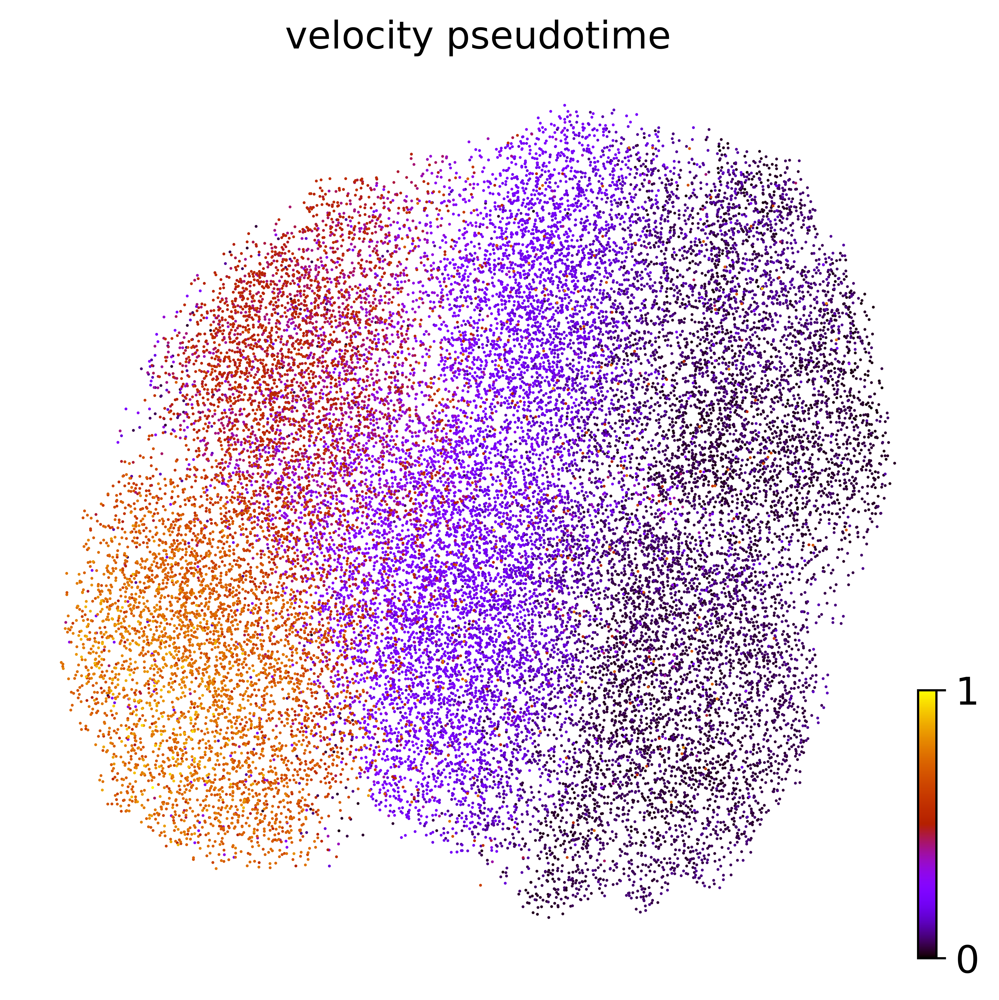

In [14]:
# Plot and save results
scv.pl.scatter(
    adata_merged,
    color="velocity_pseudotime",
    cmap="gnuplot",
    save="MUI_pseudotime.png"
)

# PAGA velocity graph

We'll run PAGA using the velocity pseudotime results

In [15]:
# this is needed due to a current bug - bugfix is coming soon.
adata_merged.uns["neighbors"]["distances"] = adata_merged.obsp["distances"]
adata_merged.uns["neighbors"]["connectivities"] = adata_merged.obsp["connectivities"]

# Set "minimum_spanning_tree = True" for dotted lines connecting the clusters
scv.tl.paga(adata_merged, groups="cell_type_coarse", minimum_spanning_tree=False)
# df = scv.get_df(adata_merged, "paga/transitions_confidence", precision=2).T # Use this with "minimum_spanning_tree = True"
df = scv.get_df(adata_merged, "paga/transitions_confidence", precision=1).T
df.style.background_gradient(cmap="Blues").format("{:.2g}")

running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:15) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/core/_anndata.py:245: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if is_categorical_dtype(data.obs[key])


,BN1,BN2,BN3,BN4,TAN1,TAN2,TAN3
BN1,0,0,0,0,0,0,0
BN2,0.47,0,0.33,0,0,0,0
BN3,0,0,0,0.51,0,0,0
BN4,0,0,0,0,0.37,0,0
TAN1,0,0,0,0,0,0,0.097
TAN2,0,0,0,0,0,0,0
TAN3,0,0,0,0,0,0.67,0


/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-package

/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])


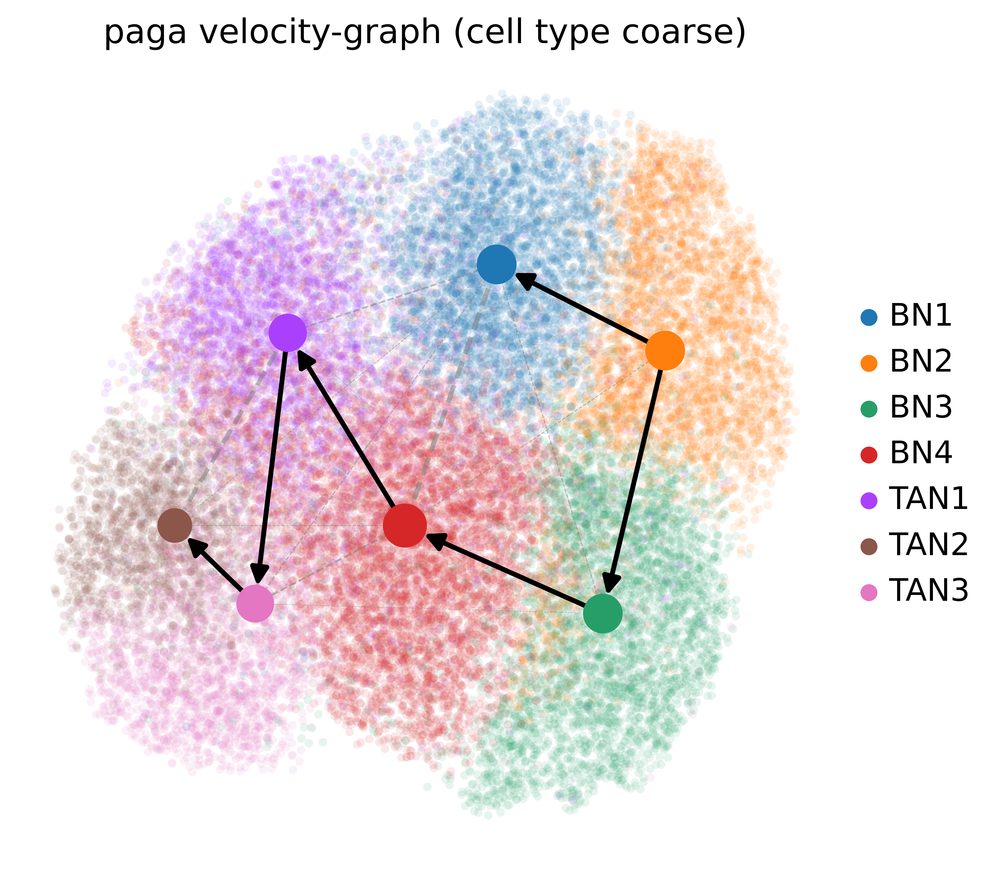

In [16]:
# Produce and save the PAGA plot
scv.pl.paga(
    adata_merged,
    basis="umap",
    size=50,
    alpha=0.1,
    min_edge_width=2,
    node_size_scale=1.5,
    color="cell_type_coarse",
    dpi=400,
    threshold=0,
    save="scvelo_PAGA_neutro.png",
)

# Dynamical (E/M) Model

In [17]:
# First we need to recover the velocity dynamics
scv.tl.recover_dynamics(adata_merged, n_jobs=4)

recovering dynamics (using 4/64 cores)


  0%|          | 0/38 [00:00<?, ?gene/s]

    finished (0:07:43) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [18]:
# Based on the above dynamics - run the EM model
scv.tl.velocity(adata_merged, mode="dynamical")
scv.tl.velocity_graph(adata_merged, n_jobs=4)

computing velocities
    finished (0:08:44) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 4/64 cores)


  0%|          | 0/27443 [00:00<?, ?cells/s]

    finished (0:03:54) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scanpy/_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotting/utils.py:63: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  return isinstance(c, str) and c in data.obs.keys() and cat(data.obs[c])
/home/fotakis/.conda/envs/scvelo2/lib/python3.10/site-packages/scvelo/plotti

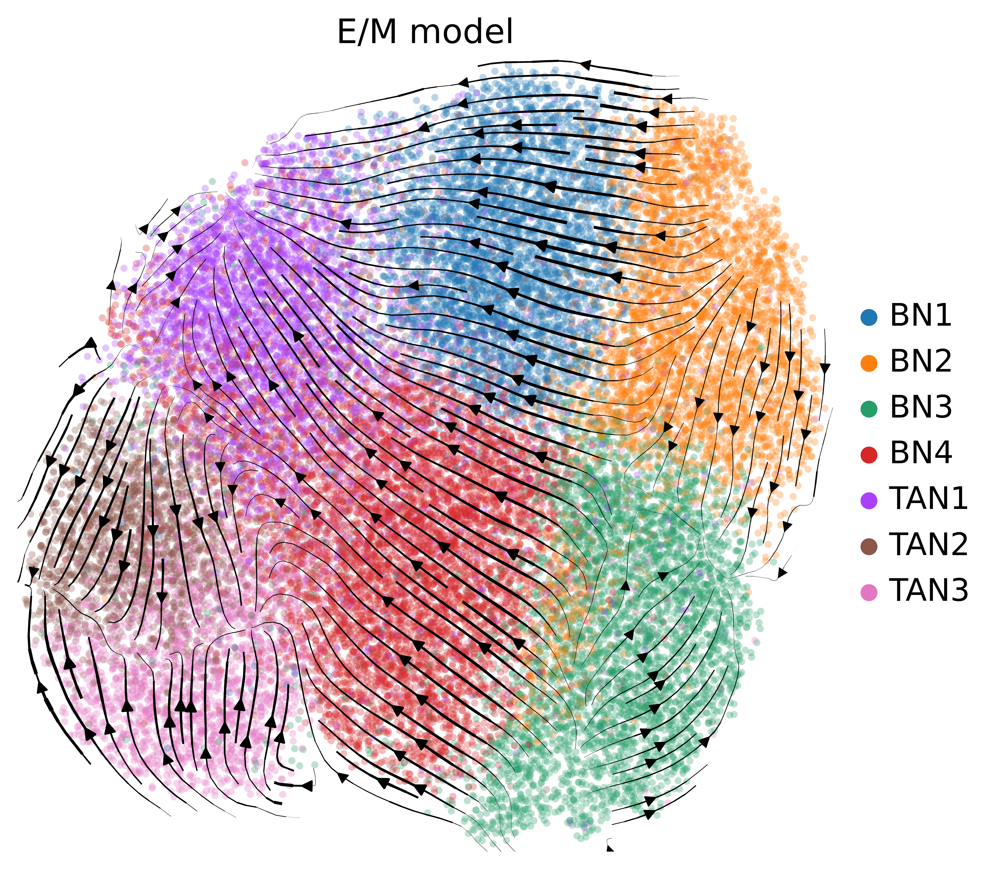

In [20]:
# Plot and save the velocity graph (EM)
# Note: The default figure params are changed here (I find these params produce more "readable" plots)
# Feel free to change
sc.set_figure_params(figsize=(6, 6), dpi=400)
# remove the grid lines
plt.rcParams["axes.grid"] = False
scv.pl.velocity_embedding_stream(
    adata_merged,
    basis="umap",
    color="cell_type_coarse",
    title="E/M model",
    legend_loc="on right",
    # save="scvelo_EM_neutro.png",
)

In [ ]:
# Compute and plot the latent time
scv.tl.latent_time(adata_merged, root_key=11)
scv.pl.scatter(adata_merged, color='latent_time', color_map='gnuplot', size=80)

computing latent time using root_cells as prior


In [ ]:
# Plot the heatmap of the top kinetic genes
top_genes = adata_merged.var['fit_likelihood'].sort_values(ascending=False).index[:300]
scv.pl.heatmap(adata_merged, var_names=top_genes, sortby='latent_time', col_color='leiden', n_convolve=100)

In [ ]:
# Plot the phase portraits of the top kinetic genes
top_genes = adata_merged.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(adata_merged, basis=top_genes[:15], ncols=5, frameon=False, color='leiden')

In [22]:
scv.tl.latent_time?

Signature:
scv.tl.latent_time(
    data,
    vkey='velocity',
    min_likelihood=0.1,
    min_confidence=0.75,
    min_corr_diffusion=None,
    weight_diffusion=None,
    root_key=None,
    end_key=None,
    t_max=None,
    copy=False,
)
Docstring:
Computes a gene-shared latent time.

Gene-specific latent timepoints obtained from the dynamical model are coupled to a
universal gene-shared latent time, which represents the cell’s internal clock and
is based only on its transcriptional dynamics.

.. image:: https://user-images.githubusercontent.com/31883718/69636500-03318e80-1057-11ea-9e14-ae9f907711cc.png

Arguments:
---------
data: :class:`~anndata.AnnData`
    Annotated data matrix
vkey: `str` (default: `'velocity'`)
    Name of velocity estimates to be used.
min_likelihood: `float` between `0` and `1` or `None` (default: `.1`)
    Minimal likelihood fitness for genes to be included to the weighting.
min_confidence: `float` between `0` and `1` (default: `.75`)
    Parameter for local c